In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Activation
from tensorflow.keras.losses import MeanSquaredError
from tensorflow.keras.optimizers import Adam

# Đường dẫn đến file dữ liệu
file_path = '../dataset/converted_data.csv'

# Đọc dữ liệu từ file CSV
new_data = pd.read_csv(file_path)

# Xóa các giá trị NaN
new_data = new_data.dropna()


In [2]:
# Đảm bảo 'date' đã được chuyển đổi thành kiểu dữ liệu datetime
new_data['date'] = pd.to_datetime(new_data['timestamp'], unit='s')

# Xóa cột 'timestamp'
df_raw = new_data.drop(columns=['timestamp'])

# Tạo một danh sách các tên cột mới
columns = ['date'] + [col for col in new_data.columns if col != 'date']

# Sắp xếp lại các cột theo danh sách
new_data = new_data[columns]

# Hiển thị DataFrame
new_data

,date,timestamp,room_temp_Mf-1-1,room_temp_Mf-1-2,room_temp_Mf-1-3,room_temp_Mf-2-1-1,room_temp_Mf-2-1-2,room_temp_Mf-2-1-3,room_temp_Mf-2-1-4,room_temp_Ac-2-1,...,slab_temp_Mf-2-1-1,slab_temp_Mf-2-1-2,slab_temp_Mf-2-1-3,slab_temp_Mf-2-1-4,slab_temp_Ac-2-1,slab_temp_Mf-2-1,slab_temp_Ac-2-2,slab_temp_Ac-2-3,slab_temp_Ac-2-4,slab_temp_Ac-2-5
620,2023-04-13 11:32:24,1681385544,17.7,18.6,18.4,20.4,21.1,19.6,19.2,19.2,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0
621,2023-04-13 12:13:22,1681388002,17.9,19.0,18.7,20.8,21.9,20.1,19.4,19.9,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0
622,2023-04-13 12:36:40,1681389400,18.0,19.1,18.8,21.3,22.1,20.3,19.8,20.1,...,16.1,16.1,16.1,16.1,16.1,16.1,16.1,16.1,16.1,16.1
623,2023-04-13 12:54:07,1681390447,18.1,19.2,18.9,21.4,22.3,20.4,19.9,20.3,...,16.1,16.1,16.1,16.1,16.1,16.1,16.1,16.1,16.1,16.1
624,2023-04-13 13:14:07,1681391647,18.2,19.4,19.0,21.7,22.5,20.5,20.2,20.4,...,16.1,16.1,16.1,16.1,16.1,16.1,16.1,16.1,16.1,16.1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12993,2023-12-07 08:39:08,1701938348,20.4,20.4,21.0,22.3,22.3,21.4,20.9,21.2,...,19.7,19.7,19.7,19.7,19.7,19.7,19.7,19.7,19.7,19.7
12994,2023-12-07 08:59:13,1701939553,20.4,20.5,21.0,22.6,22.4,21.4,20.9,21.2,...,19.7,19.7,19.7,19.7,19.7,19.7,19.7,19.7,19.7,19.7
12995,2023-12-07 09:19:08,1701940748,20.4,20.5,21.0,22.8,22.6,21.5,20.9,21.3,...,19.7,19.7,19.7,19.7,19.7,19.7,19.7,19.7,19.7,19.7
12996,2023-12-07 09:39:10,1701941950,20.5,20.6,21.0,22.9,22.7,21.5,21.0,21.4,...,19.6,19.6,19.6,19.6,19.6,19.6,19.6,19.6,19.6,19.6


In [3]:
new_data.describe()

,timestamp,room_temp_Mf-1-1,room_temp_Mf-1-2,room_temp_Mf-1-3,room_temp_Mf-2-1-1,room_temp_Mf-2-1-2,room_temp_Mf-2-1-3,room_temp_Mf-2-1-4,room_temp_Ac-2-1,fan_stat_Ac-2-1,...,slab_temp_Mf-2-1-1,slab_temp_Mf-2-1-2,slab_temp_Mf-2-1-3,slab_temp_Mf-2-1-4,slab_temp_Ac-2-1,slab_temp_Mf-2-1,slab_temp_Ac-2-2,slab_temp_Ac-2-3,slab_temp_Ac-2-4,slab_temp_Ac-2-5
count,1.237800e+04,12378.000000,12378.000000,12378.000000,12378.000000,12378.000000,12378.000000,12378.000000,12378.000000,12378.000000,...,12378.000000,12378.000000,12378.000000,12378.000000,12378.000000,12378.000000,12378.000000,12378.000000,12378.000000,12378.000000
mean,1.691786e+09,18.709654,19.869939,19.956318,20.690604,21.114388,20.578413,19.695306,19.602141,0.177250,...,18.224552,18.224552,18.224552,18.224552,18.224552,18.224552,18.224552,18.224552,18.224552,18.224552
std,6.552325e+06,1.746228,1.776299,1.535705,1.740456,1.652411,1.781580,2.221728,2.511852,0.381896,...,1.147145,1.147145,1.147145,1.147145,1.147145,1.147145,1.147145,1.147145,1.147145,1.147145
min,1.681386e+09,14.300000,14.300000,14.900000,16.200000,16.200000,15.200000,14.100000,14.100000,0.000000,...,13.800000,13.800000,13.800000,13.800000,13.800000,13.800000,13.800000,13.800000,13.800000,13.800000
25%,1.685361e+09,17.500000,18.600000,18.900000,19.400000,19.900000,19.300000,18.000000,17.600000,0.000000,...,17.600000,17.600000,17.600000,17.600000,17.600000,17.600000,17.600000,17.600000,17.600000,17.600000
50%,1.693270e+09,18.600000,19.800000,20.000000,20.600000,21.000000,20.500000,19.600000,19.400000,0.000000,...,18.400000,18.400000,18.400000,18.400000,18.400000,18.400000,18.400000,18.400000,18.400000,18.400000
75%,1.697243e+09,19.800000,21.200000,21.000000,22.000000,22.300000,21.775000,21.300000,21.500000,0.000000,...,18.900000,18.900000,18.900000,18.900000,18.900000,18.900000,18.900000,18.900000,18.900000,18.900000
max,1.701943e+09,24.600000,25.400000,24.900000,26.600000,27.500000,27.800000,28.100000,29.500000,1.000000,...,21.700000,21.700000,21.700000,21.700000,21.700000,21.700000,21.700000,21.700000,21.700000,21.700000


In [4]:
selected_data = new_data.drop(columns=['room_sp_value', 'room_sp_range', 'slab_sp_range', 'slab_sp_value', 'thermal_comfort_data_Mf-1-1', 'thermal_comfort_data_Mf-1-2', 'thermal_comfort_data_Mf-1-3', 'thermal_comfort_data_Mf-2-1-1', 'thermal_comfort_data_Mf-2-1-2', 'thermal_comfort_data_Mf-2-1-3', 'thermal_comfort_data_Mf-2-1-4', 'thermal_comfort_data_Ac-2-1', 'issues_count_Mf-1-1', 'issues_count_Mf-1-2', 'issues_count_Mf-1-3', 'issues_count_Mf-2-1-1', 'issues_count_Mf-2-1-2', 'issues_count_Mf-2-1-3', 'issues_count_Mf-2-1-4', 'issues_count_Ac-2-1', 'potential_savings_Mf-1-1', 'potential_savings_Mf-1-2', 'potential_savings_Mf-1-3', 'potential_savings_Mf-2-1-1', 'potential_savings_Mf-2-1-2', 'potential_savings_Mf-2-1-3', 'potential_savings_Mf-2-1-4', 'potential_savings_Ac-2-1'])

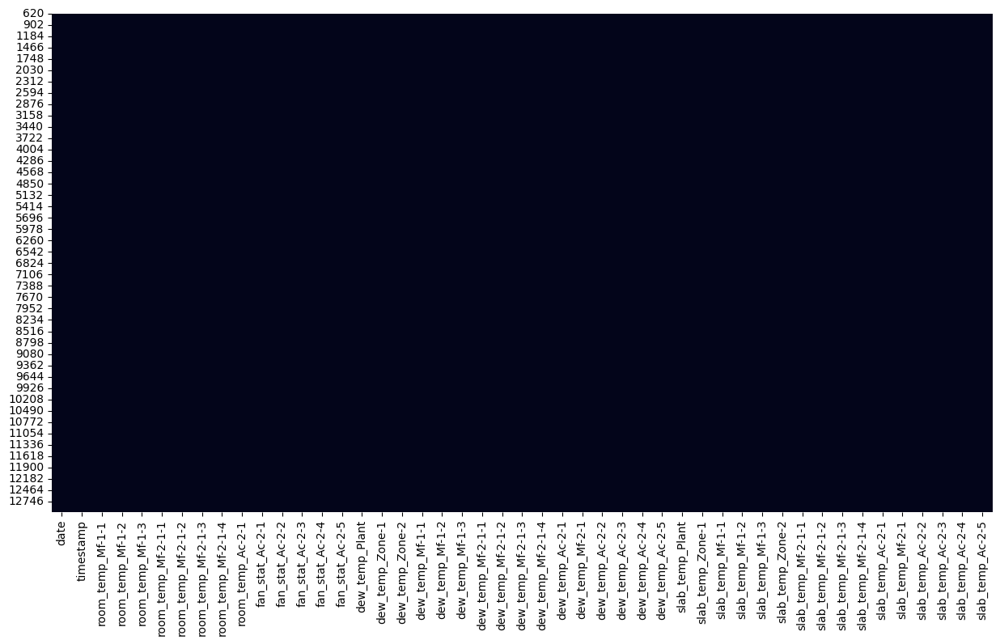

In [7]:
import seaborn as sns

plt.figure(figsize=(15, 8))
sns.heatmap(selected_data.isna(), cbar=False)
plt.show()

In [8]:
# Hiển thị DataFrame
selected_data

,date,timestamp,room_temp_Mf-1-1,room_temp_Mf-1-2,room_temp_Mf-1-3,room_temp_Mf-2-1-1,room_temp_Mf-2-1-2,room_temp_Mf-2-1-3,room_temp_Mf-2-1-4,room_temp_Ac-2-1,...,slab_temp_Mf-2-1-1,slab_temp_Mf-2-1-2,slab_temp_Mf-2-1-3,slab_temp_Mf-2-1-4,slab_temp_Ac-2-1,slab_temp_Mf-2-1,slab_temp_Ac-2-2,slab_temp_Ac-2-3,slab_temp_Ac-2-4,slab_temp_Ac-2-5
620,2023-04-13 11:32:24,1681385544,17.7,18.6,18.4,20.4,21.1,19.6,19.2,19.2,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0
621,2023-04-13 12:13:22,1681388002,17.9,19.0,18.7,20.8,21.9,20.1,19.4,19.9,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0
622,2023-04-13 12:36:40,1681389400,18.0,19.1,18.8,21.3,22.1,20.3,19.8,20.1,...,16.1,16.1,16.1,16.1,16.1,16.1,16.1,16.1,16.1,16.1
623,2023-04-13 12:54:07,1681390447,18.1,19.2,18.9,21.4,22.3,20.4,19.9,20.3,...,16.1,16.1,16.1,16.1,16.1,16.1,16.1,16.1,16.1,16.1
624,2023-04-13 13:14:07,1681391647,18.2,19.4,19.0,21.7,22.5,20.5,20.2,20.4,...,16.1,16.1,16.1,16.1,16.1,16.1,16.1,16.1,16.1,16.1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12993,2023-12-07 08:39:08,1701938348,20.4,20.4,21.0,22.3,22.3,21.4,20.9,21.2,...,19.7,19.7,19.7,19.7,19.7,19.7,19.7,19.7,19.7,19.7
12994,2023-12-07 08:59:13,1701939553,20.4,20.5,21.0,22.6,22.4,21.4,20.9,21.2,...,19.7,19.7,19.7,19.7,19.7,19.7,19.7,19.7,19.7,19.7
12995,2023-12-07 09:19:08,1701940748,20.4,20.5,21.0,22.8,22.6,21.5,20.9,21.3,...,19.7,19.7,19.7,19.7,19.7,19.7,19.7,19.7,19.7,19.7
12996,2023-12-07 09:39:10,1701941950,20.5,20.6,21.0,22.9,22.7,21.5,21.0,21.4,...,19.6,19.6,19.6,19.6,19.6,19.6,19.6,19.6,19.6,19.6


Epoch 1/100
310/310 [==============================] - 2s 3ms/step - loss: 0.6534 - accuracy: 0.0739
Epoch 2/100
310/310 [==============================] - 1s 3ms/step - loss: 0.4448 - accuracy: 0.0745
Epoch 3/100
310/310 [==============================] - 1s 3ms/step - loss: 0.3745 - accuracy: 0.0627
Epoch 4/100
310/310 [==============================] - 1s 2ms/step - loss: 0.3492 - accuracy: 0.0529
Epoch 5/100
310/310 [==============================] - 1s 2ms/step - loss: 0.3406 - accuracy: 0.0567
Epoch 6/100
310/310 [==============================] - 1s 2ms/step - loss: 0.3277 - accuracy: 0.0649
Epoch 7/100
310/310 [==============================] - 1s 3ms/step - loss: 0.3206 - accuracy: 0.0635
Epoch 8/100
310/310 [==============================] - 1s 2ms/step - loss: 0.3198 - accuracy: 0.0720
Epoch 9/100
310/310 [==============================] - 1s 2ms/step - loss: 0.3133 - accuracy: 0.0740
Epoch 10/100
310/310 [==============================] - 1s 2ms/step - loss: 0.3121 - accura

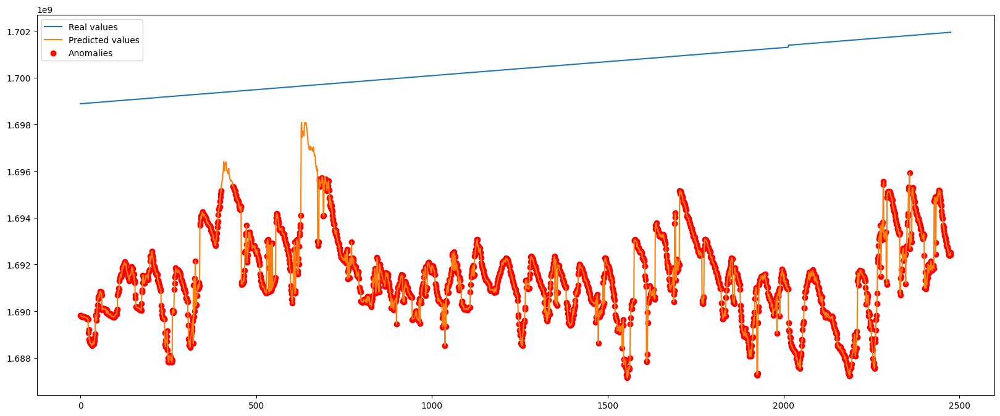

In [9]:
# Chuyển đổi dữ liệu về dạng chuẩn
scaler = StandardScaler()
selected_data_scaled = scaler.fit_transform(selected_data.drop('date', axis=1))

# Chia dữ liệu thành tập huấn luyện và tập kiểm tra
X_train = selected_data_scaled[:int(len(selected_data_scaled)*0.8)]
X_test = selected_data_scaled[int(len(selected_data_scaled)*0.8):]

# Tạo mô hình autoencoder
model = Sequential()
model.add(Dense(128, activation='relu', input_dim=X_train.shape[1]))
model.add(Dropout(0.2))
model.add(Dense(64, activation='relu'))
model.add(Dropout(0.2))
model.add(Dense(32, activation='relu'))
model.add(Dropout(0.2))
model.add(Dense(16, activation='relu'))
model.add(Dropout(0.2))
model.add(Dense(8, activation='relu'))
model.add(Dropout(0.2))
model.add(Dense(46, activation='linear'))  # Số nơ-ron ở lớp này phải bằng với số tính năng đầu vào

# Khởi tạo bộ tối ưu hóa và hàm mất mát
optimizer = Adam(learning_rate=0.001)
loss = MeanSquaredError()

# Đánh giá mô hình
model.compile(optimizer=optimizer, loss=loss, metrics=['accuracy'])

# Huấn luyện mô hình
model.fit(X_train, X_train, epochs=100, batch_size=32)

# Đánh giá mô hình trên tập kiểm tra
model.evaluate(X_test, X_test)

# Tính toán độ lệch chuẩn của các dự đoán
y_pred = model.predict(X_test)
y_pred_std = scaler.inverse_transform(y_pred)
y_test_std = scaler.inverse_transform(X_test)
std = np.std(y_pred_std - y_test_std)

# # Tìm các điểm bất thường
# anomaly_scores = np.abs(y_pred_std - y_test_std)
# anomalies = np.where(anomaly_scores > 3*std)[0]

# # Vẽ đồ thị
# plt.figure(figsize=(20, 8))  # Đặt kích thước biểu đồ là 15x8 inch
# plt.plot(y_test_std[:, 0], label='Real values')  # Chỉ sử dụng một cột để vẽ
# plt.plot(y_pred_std[:, 0], label='Predicted values')  # Chỉ sử dụng một cột để vẽ
# plt.scatter(anomalies, y_pred_std[anomalies, 0], color='red', label='Anomalies')  # Chỉ sử dụng một cột và các chỉ số hợp lệ
# plt.legend()
# plt.show()

In [10]:
import matplotlib.pyplot as plt

# Giả sử bạn muốn vẽ biểu đồ cho 3 tính năng đầu tiên
num_features_to_plot = 46

# Lấy tên của các cột từ DataFrame
feature_names = selected_data.drop('timestamp', axis=1).columns

# Vẽ biểu đồ
plt.figure(figsize=(20, 6 * num_features_to_plot))

for i in range(num_features_to_plot):
    plt.subplot(num_features_to_plot, 1, i + 1)
    plt.plot(y_test_std[:, i], label=f'Real Value - {feature_names[i]}')
    plt.plot(y_pred_std[:, i], label=f'Predicted Value - {feature_names[i]}', alpha=0.7)
    plt.scatter(anomalies, y_pred_std[anomalies, i], color='red', label='Anomalies')
    plt.title(feature_names[i])
    plt.legend()

plt.tight_layout()
plt.show()



In [12]:
import numpy as np
import matplotlib.pyplot as plt

# Tính toán sai số cho mỗi channel
anomaly_scores = np.abs(y_pred_std - y_test_std)

# Tính toán độ lệch chuẩn cho mỗi channel
std_per_channel = np.std(anomaly_scores, axis=0)

# Xác định ngưỡng để phát hiện bất thường
threshold = 3 * std_per_channel

# Tìm các điểm bất thường cho mỗi channel
anomalies_per_channel = [np.where(anomaly_scores[:, i] > threshold[i])[0] for i in range(anomaly_scores.shape[1])]

# Lấy tên của các cột từ DataFrame
feature_names = selected_data.drop('timestamp', axis=1).columns

# Số lượng tính năng bạn muốn vẽ
num_features_to_plot = 46  # Vẽ tối đa 3 tính năng

# Vẽ biểu đồ
plt.figure(figsize=(20, 6 * num_features_to_plot))

for i in range(num_features_to_plot):
    plt.subplot(num_features_to_plot, 1, i + 1)
    plt.plot(y_test_std[:, i], label=f'Real Value - {feature_names[i]}')
    plt.plot(y_pred_std[:, i], label=f'Predicted Value - {feature_names[i]}', alpha=0.7)
    plt.scatter(anomalies_per_channel[i], y_pred_std[anomalies_per_channel[i], i], color='red', label='Anomalies')
    plt.title(feature_names[i])
    plt.legend()

plt.tight_layout()
plt.show()
